In [2]:
# Imports Stuff
import keras
from keras.models import Model
from keras import backend as K
from keras.layers import (
    Input, 
    concatenate, 
    Conv2D,
    MaxPooling2D,
    Conv2DTranspose,
    ZeroPadding2D  # Move this here
)
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Reshape, Dense, Flatten

import vtk
from vtm_data import VTK_data
import numpy as np
import matplotlib.pyplot as plt
from pathlib import Path
import os


In [2]:
# training params
batch_size = 32
epochs = 50 # number of times through training set

In [3]:
# load dataset

class VTK_data:
    def __init__(self, base_path, split_ratio=0.8):
        self.base_path = Path(base_path)
        self.data = []
        self.geometries = []
        self.steady_flows = []
        self.split_ratio = split_ratio
        self.split_line = 0
        
    def load_data(self):
        for dirpath, dirnames, filenames in os.walk(self.base_path):
            for filename in filenames:
                if filename.endswith('.vtm'):
                    full_path = Path(dirpath) / filename
                    try:
                        data = self._load_single_file(full_path)
                        if data is not None:
                            print(f"\nProcessing file: {filename}")
                            print(f"Full path: {full_path}")
                            
                            # Updated classification logic
                            if 'geometry' in filename:
                                print(f"Classified as geometry file")
                                self.geometries.append(data)
                            elif 'cylinder2d_iT' in filename:
                                print(f"Classified as flow file")
                                self.steady_flows.append(data)
                            else:
                                print(f"Skipping file: {filename}")
                    except Exception as e:
                        print(f"Error loading {full_path}: {str(e)}")
        
        print("\nLoaded data summary:")
        print(f"Number of geometry files: {len(self.geometries)}")
        if self.geometries:
            print(f"Shape of first geometry: {np.array(self.geometries[0]).shape}")
        
        print(f"Number of flow files: {len(self.steady_flows)}")
        if self.steady_flows:
            print(f"Shape of first flow: {np.array(self.steady_flows[0]).shape}")
        
        total_samples = len(self.geometries)
        self.split_line = int(total_samples * self.split_ratio)
        
        return self.geometries, self.steady_flows
    
    def _load_single_file(self, file_path):
        reader = vtk.vtkXMLMultiBlockDataReader()
        reader.SetFileName(str(file_path))
        reader.Update()
        
        if reader.GetErrorCode() != 0:
            raise RuntimeError(f"Error reading file")
        
        data = reader.GetOutput()
        if data is None:
            raise RuntimeError("No data read from file")
            
        data_iterator = data.NewIterator()
        img_data = data_iterator.GetCurrentDataObject()
        
        if img_data is None:
            raise RuntimeError("No image data found in file")
        
        if hasattr(img_data, 'GetProducerPort'):
            producer = img_data.GetProducerPort()
            if producer:
                producer.Update()
        elif hasattr(img_data, 'GetSource'):
            source = img_data.GetSource()
            if source:
                source.Update()
                
        point_data = img_data.GetPointData()
        array_data = point_data.GetArray(0)
        array_data = vtk.util.numpy_support.vtk_to_numpy(array_data)
        
        return array_data

# Create instance and load data
base_directory = "/mnt/data/cfd-ml-examples/sumulation"
dataset = VTK_data(base_directory)

# Load the data
geometries, steady_flows = dataset.load_data()

if len(dataset.geometries) > 0 and len(dataset.steady_flows) > 0:
    # Get train and test split
    train_geometries = dataset.geometries[0:dataset.split_line]
    train_steady_flows = dataset.steady_flows[0:dataset.split_line]
    test_geometries = dataset.geometries[dataset.split_line:-1]
    test_steady_flows = dataset.steady_flows[dataset.split_line:-1]
    
    print("\nData split sizes:")
    print(f"Train geometries: {len(train_geometries)}")
    print(f"Train flows: {len(train_steady_flows)}")
    print(f"Test geometries: {len(test_geometries)}")
    print(f"Test flows: {len(test_steady_flows)}")
    
    # Convert to numpy arrays
    train_geometries = np.stack(train_geometries, axis=0)
    train_steady_flows = np.stack(train_steady_flows, axis=0)
    test_geometries = np.stack(test_geometries, axis=0)
    test_steady_flows = np.stack(test_steady_flows, axis=0)
    
    print("\nFinal array shapes:")
    print(f"Train geometries shape: {train_geometries.shape}")
    print(f"Train flows shape: {train_steady_flows.shape}")
    print(f"Test geometries shape: {test_geometries.shape}")
    print(f"Test flows shape: {test_steady_flows.shape}")
else:
    print("\nERROR: Missing either geometry or flow data!")


Processing file: geometry_iT0000000.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlog_01483/vtkData/geometry_iT0000000.vtm
Classified as geometry file

Processing file: cuboid_iT0000000.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlog_01483/vtkData/cuboid_iT0000000.vtm
Skipping file: cuboid_iT0000000.vtm

Processing file: rank_iT0000000.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlog_01483/vtkData/rank_iT0000000.vtm
Skipping file: rank_iT0000000.vtm

Processing file: cylinder2d_iT0032530.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlog_01483/vtkData/data/cylinder2d_iT0032530.vtm
Classified as flow file

Processing file: geometry_iT0000000.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlog_01484/vtkData/geometry_iT0000000.vtm
Classified as geometry file

Processing file: cuboid_iT0000000.vtm
Full path: /mnt/data/cfd-ml-examples/sumulation/simulation_data/runlo

In [4]:
# get train and test split
train_geometries = dataset.geometries[0:dataset.split_line]
train_steady_flows = dataset.steady_flows[0:dataset.split_line]
test_geometries = dataset.geometries[dataset.split_line:-1]
test_steady_flows = dataset.steady_flows[dataset.split_line:-1]

print(f"Training set size: {len(train_geometries)} samples")
print(f"Test set size: {len(test_geometries)} samples")

Training set size: 1600 samples
Test set size: 399 samples


In [5]:
# reshape into single np array
train_geometries = np.stack(train_geometries, axis=0)
train_steady_flows = np.stack(train_steady_flows, axis=0)
test_geometries = np.stack(test_geometries, axis=0)
test_steady_flows = np.stack(test_steady_flows, axis=0)

In [6]:
# print dataset values
print('geometry shape:', train_geometries.shape[1:])
print('steady flow shape:', train_steady_flows.shape[1:])
print(train_geometries.shape[0], ' train samples')
print(test_geometries.shape[0], ' test samples')

geometry shape: (9812,)
steady flow shape: (9812, 2)
1600  train samples
399  test samples


In [8]:
# Import all necessary layers
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Reshape, Dense, Flatten, concatenate, Conv2DTranspose, ZeroPadding2D

# Define input layer to match your geometry data shape
inputs = Input(shape=(9812,))

# Initial reshape to work with convolutions
# We reshape to (44, 223, 1) for processing
reshaped = Reshape((44, 223, 1))(inputs)

# Encoder Path (Downsampling)
# First block
conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(reshaped)
conv1 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv1)
pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

# Second block
conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(pool1)
conv2 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv2)
pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

# Third block
conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(pool2)
conv3 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv3)
pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)

# Fourth block
conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(pool3)
conv4 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv4)
pool4 = MaxPooling2D(pool_size=(2, 2))(conv4)

# Bridge
conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(pool4)
conv5 = Conv2D(512, (3, 3), activation='relu', padding='same')(conv5)

# Decoder Path (Upsampling)
# First upsampling block
up6 = concatenate([ZeroPadding2D(((1,0),(1,0)))(Conv2DTranspose(256, (2, 2), strides=(2, 2), padding='same')(conv5)), conv4], axis=3)
conv6 = Conv2D(256, (3, 3), activation='relu', padding='same')(up6)
conv6 = Conv2D(256, (3, 3), activation='relu', padding='same')(conv6)

# Second upsampling block
up7 = concatenate([ZeroPadding2D(((1,0),(1,0)))(Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(conv6)), conv3], axis=3)
conv7 = Conv2D(128, (3, 3), activation='relu', padding='same')(up7)
conv7 = Conv2D(128, (3, 3), activation='relu', padding='same')(conv7)

# Third upsampling block
up8 = concatenate([ZeroPadding2D(((0,0),(1,0)))(Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(conv7)), conv2], axis=3)
conv8 = Conv2D(64, (3, 3), activation='relu', padding='same')(up8)
conv8 = Conv2D(64, (3, 3), activation='relu', padding='same')(conv8)

# Fourth upsampling block
up9 = concatenate([ZeroPadding2D(((0,0),(1,0)))(Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(conv8)), conv1], axis=3)
conv9 = Conv2D(32, (3, 3), activation='relu', padding='same')(up9)
conv9 = Conv2D(32, (3, 3), activation='relu', padding='same')(conv9)

# Convolutional output before reshaping
conv10 = Conv2D(2, (1, 1), activation='linear')(conv9)

# Final reshape to match your target shape
final_output = Reshape((9812, 2))(conv10)

# Create the model with the correct output shape
model = Model(inputs=inputs, outputs=final_output)

# Compile the model
model.compile(
    loss='mse',
    optimizer=keras.optimizers.Adam(learning_rate=1e-4),
    metrics=['MSE']
)

In [9]:
print("Input shape (train_geometries):", train_geometries.shape)
print("Output shape (train_steady_flows):", train_steady_flows.shape)

Input shape (train_geometries): (1600, 9812)
Output shape (train_steady_flows): (1600, 9812, 2)


In [10]:
model.summary()

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 9812)      │          0 │ -                 │
│ (InputLayer)        │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reshape_2 (Reshape) │ (None, 44, 223,   │          0 │ input_layer_1[0]… │
│                     │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_19 (Conv2D)  │ (None, 44, 223,   │        320 │ reshape_2[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_20 (Conv2D)  │ (None, 44, 223,   │      9,248 │ conv2d_19[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_4     │ (None, 22, 111,   │          0 │ conv2d_20[0][0]   │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_21 (Conv2D)  │ (None, 22, 111,   │     18,496 │ max_pooling2d_4[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 22, 111,   │     36,928 │ conv2d_21[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_5     │ (None, 11, 55,    │          0 │ conv2d_22[0][0]   │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 11, 55,    │     73,856 │ max_pooling2d_5[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 11, 55,    │    147,584 │ conv2d_23[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_6     │ (None, 5, 27,     │          0 │ conv2d_24[0][0]   │
│ (MaxPooling2D)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 5, 27,     │    295,168 │ max_pooling2d_6[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 5, 27,     │    590,080 │ conv2d_25[0][0]   │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_7     │ (None, 2, 13,     │          0 │ conv2d_26[0][0]   │
│ (MaxPooling2D)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_27 (Conv2D)  │ (None, 2, 13,     │  1,180,160 │ max_pooling2d_7[… │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_28 (Conv2D)  │ (None, 2, 13,     │  2,359,808 │ conv2d_27[0][0]   │
│                     │ 512)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_transpose_4  │ (None, 4, 26,     │    524,544 │ conv2d_28[0][0] 

 Total params: 7,759,554 (29.60 MB)

 Trainable params: 7,759,554 (29.60 MB)

 Non-trainable params: 0 (0.00 B)

In [11]:
# First, let's check the current shapes
print("Original shapes:")
print("Train geometries shape:", train_geometries.shape)
print("Train steady flows shape:", train_steady_flows.shape)

Original shapes:
Train geometries shape: (1600, 9812)
Train steady flows shape: (1600, 9812, 2)


In [12]:
# Train the model using the original data shapes
model.fit(train_geometries, train_steady_flows,
          batch_size=batch_size,
          epochs=epochs,
          verbose=1,
          validation_data=(test_geometries, test_steady_flows))

Epoch 1/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 46s 843ms/step - MSE: 0.0251 - loss: 0.0251 - val_MSE: 0.0094 - val_loss: 0.0094
Epoch 2/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 834ms/step - MSE: 0.0090 - loss: 0.0090 - val_MSE: 0.0052 - val_loss: 0.0052
Epoch 3/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 831ms/step - MSE: 0.0041 - loss: 0.0041 - val_MSE: 0.0018 - val_loss: 0.0018
Epoch 4/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 833ms/step - MSE: 0.0016 - loss: 0.0016 - val_MSE: 9.9060e-04 - val_loss: 9.9060e-04
Epoch 5/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 833ms/step - MSE: 9.3704e-04 - loss: 9.3704e-04 - val_MSE: 7.0832e-04 - val_loss: 7.0832e-04
Epoch 6/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 835ms/step - MSE: 6.8192e-04 - loss: 6.8192e-04 - val_MSE: 5.8297e-04 - val_loss: 5.8297e-04
Epoch 7/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 835ms/step - MSE: 5.8100e-04 - loss: 5.8100e-04 - val_MSE: 5.4829e-04 - val_loss: 5.4829e-04
Epoch 8/50
50/50 ━━━━━━━━━━━━━━━━━━━━ 42s 833ms/step - MSE: 5.2867e-04 - loss: 5.2867e-04 - val_MSE: 4.5728e-04

In [13]:
# evaluate on test set
score = model.evaluate(test_geometries, test_steady_flows, verbose=0)
print('Average Mean Squared Error:', score[0])

Average Mean Squared Error: 0.00022253750648815185


13/13 ━━━━━━━━━━━━━━━━━━━━ 3s 235ms/step


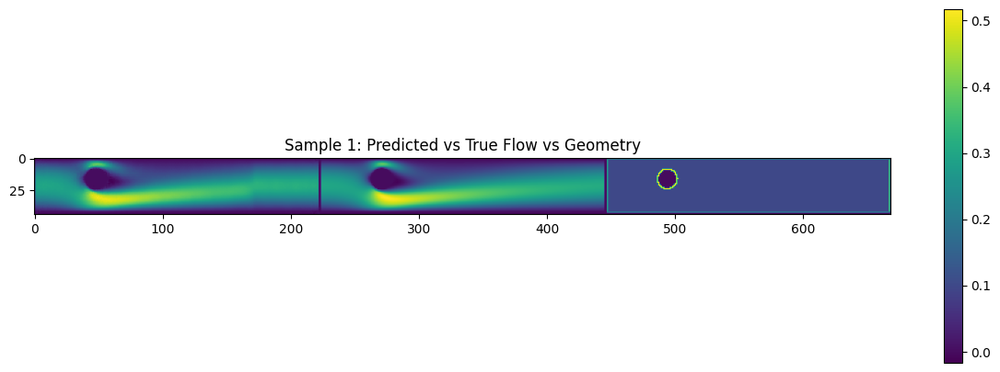

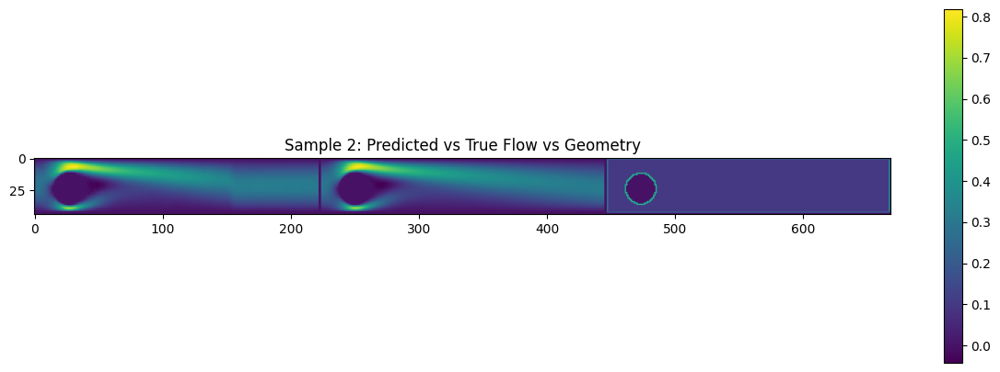

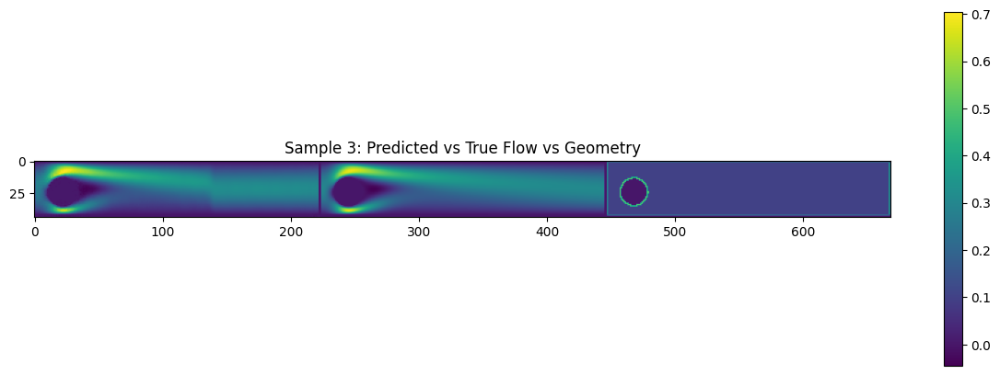

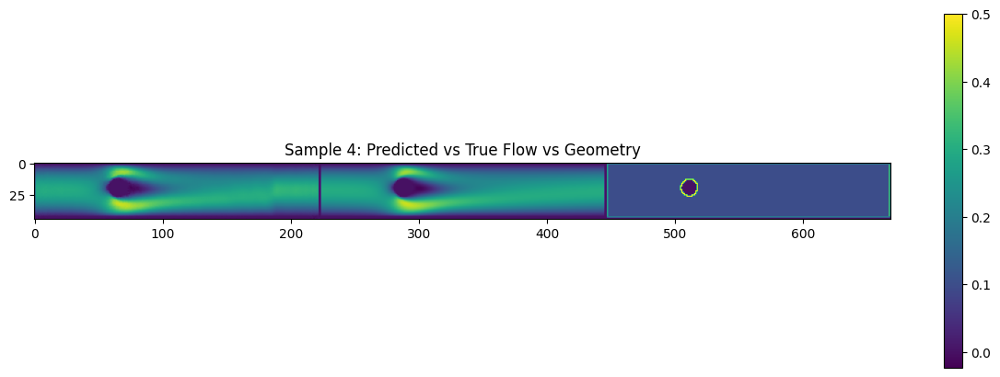

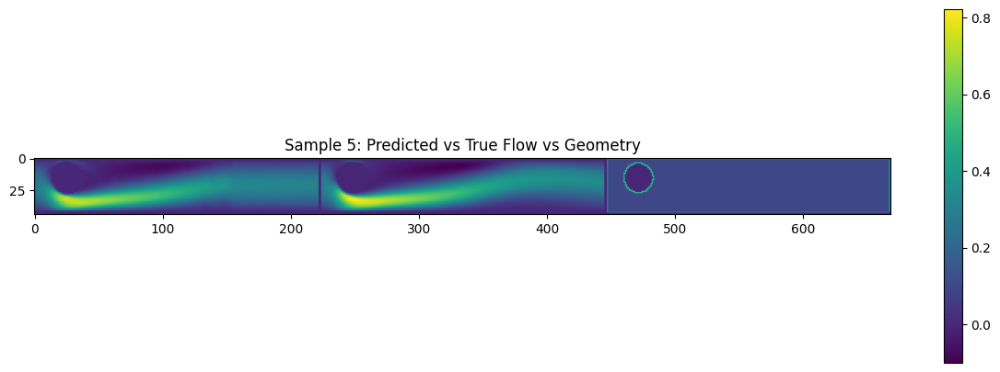

...

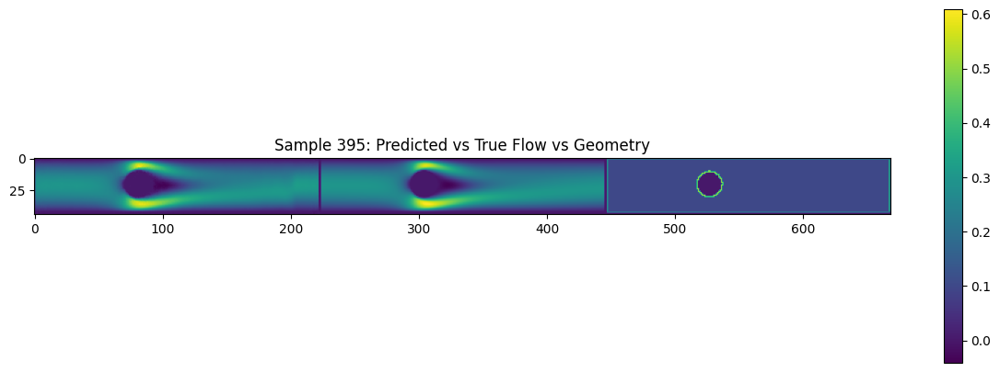

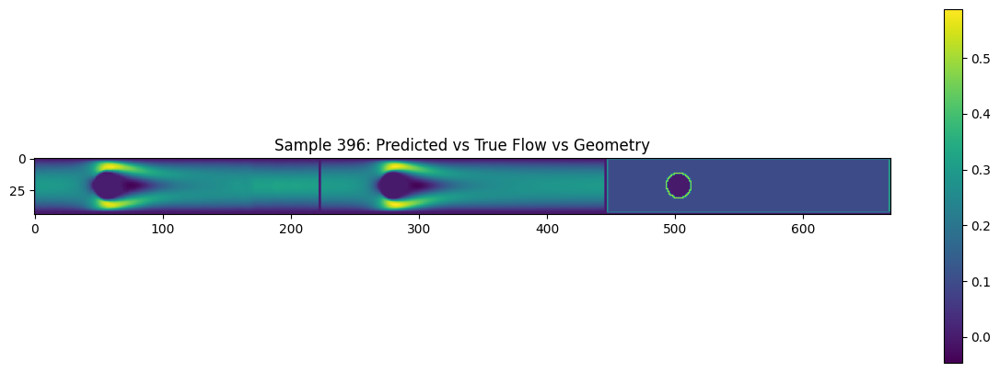

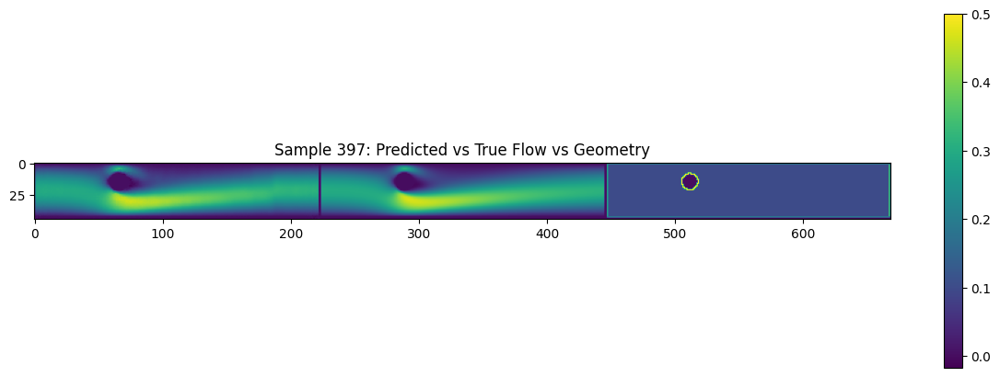

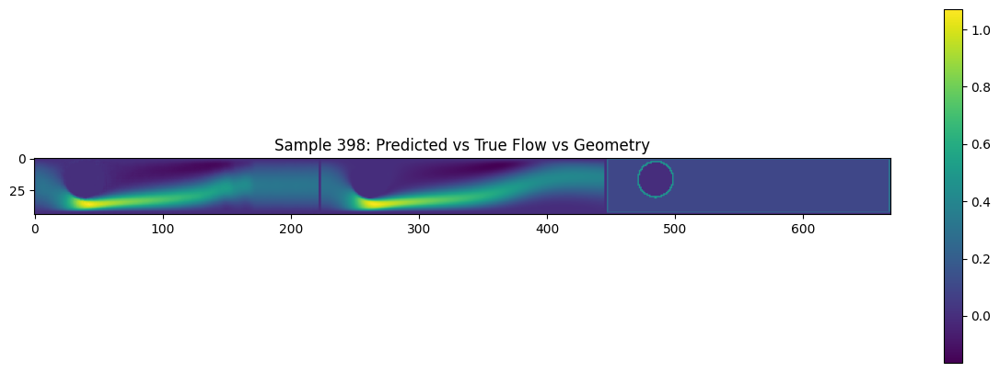

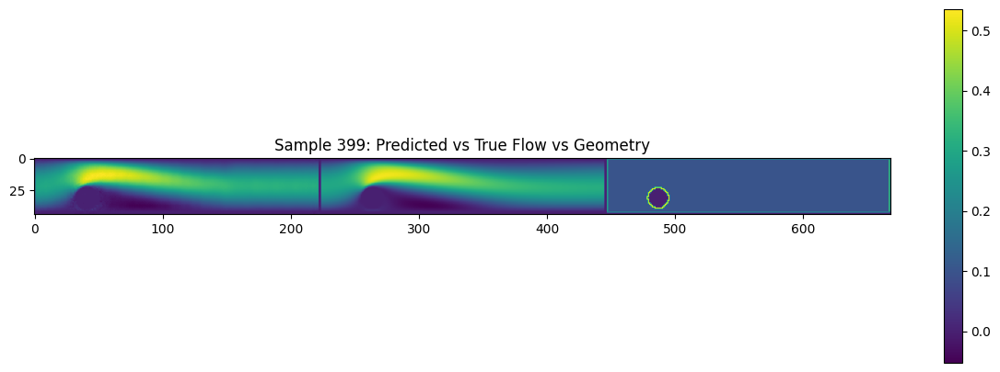

In [14]:
# Display predictions on test set
predicted_steady_flow = model.predict(test_geometries, batch_size=batch_size)

for i in range(predicted_steady_flow.shape[0]):
    # Note: We need to modify the concatenation since our data structure has changed
    # Our predicted and actual data is now in shape (9812, 2) rather than (height, width, channels)
    
    # Reshape the data back to 2D format for visualization
    pred_reshaped = predicted_steady_flow[i].reshape(44, 223, 2)
    true_reshaped = test_steady_flows[i].reshape(44, 223, 2)
    geom_reshaped = test_geometries[i].reshape(44, 223)
    
    # Create visualization for the flow field
    velocity_image = np.concatenate([
        pred_reshaped[:,:,0],      # Predicted first component
        true_reshaped[:,:,0],      # True first component
        geom_reshaped/10.0         # Geometry (scaled for better visualization)
    ], axis=1)
    
    plt.figure(figsize=(15, 5))
    plt.imshow(velocity_image)
    plt.title(f'Sample {i+1}: Predicted vs True Flow vs Geometry')
    plt.colorbar()
    plt.show()